In [ ]:
!pip install plotly --upgrade

In [2]:
import requests
from IPython.core.display import HTML

In [3]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib
import datetime
import matplotlib.pyplot as plt
%matplotlib inline

import geopandas
import shapely
from urllib.request import urlopen
import json
#import shapefile
import plotly
from urllib.request import urlopen
from plotly.figure_factory._county_choropleth import create_choropleth
import plotly.express as px
from plotly.subplots import make_subplots
#import cufflinks as cf
from plotly.offline import download_plotlyjs, plot,iplot
import plotly.graph_objects as go
import plotly.io as pio
from matplotlib import dates as mdates

# 1. COVID cases

In [4]:
# load counties
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

# Load population data
population = pd.read_csv("data/covid_cases/covid_county_population_usafacts.csv")
population = population[(population['countyFIPS'] != 0) & (population['countyFIPS'] != 6000)]
population['fip'] = population['countyFIPS'].apply(lambda x: str(x).zfill(5))
population['population_draw'] = population['population']/10000
population.head()

ModuleNotFoundError: No module named 'numpy.core._multiarray_umath'

,countyFIPS,County Name,State,population,fip,population_draw
1,1001,Autauga County,AL,55869,01001,5.5869
2,1003,Baldwin County,AL,223234,01003,22.3234
3,1005,Barbour County,AL,24686,01005,2.4686
4,1007,Bibb County,AL,22394,01007,2.2394
5,1009,Blount County,AL,57826,01009,5.7826


In [5]:
# population data visualization
fig = px.choropleth(population, 
                    geojson=counties, 
                    locations='fip', color='population_draw',
                           #color_continuous_scale="Viridis",
                           range_color=(0, 50),
                           scope="usa",
                           labels={'unemp':'unemployment rate'}
                          )
fig.update_layout(title_text = 'population',)

fig.write_image('graphs/population.png',  format = "png", scale=2, engine="kaleido")


In [6]:
# load case data
case = pd.read_csv("data/covid_cases/covid_confirmed_usafacts_new.csv")
case['fip'] = case['countyFIPS'].apply(lambda x: str(x).zfill(5))
case.head()

,countyFIPS,County Name,State,stateFIPS,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,11/1/20,11/2/20,11/3/20,11/4/20,11/5/20,11/6/20,11/7/20,11/8/20,11/9/20,fip
0,0,Statewide Unallocated,AL,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,00000
1,1001,Autauga County,AL,1,0,0,0,0,0,0,...,2173,2186,2197,2212,2230,2242,2267,2283,2304,01001
2,1003,Baldwin County,AL,1,0,0,0,0,0,0,...,6966,6985,6995,7061,7097,7134,7188,7226,7263,01003
3,1005,Barbour County,AL,1,0,0,0,0,0,0,...,1061,1065,1074,1079,1080,1090,1092,1095,1098,01005
4,1007,Bibb County,AL,1,0,0,0,0,0,0,...,878,883,890,897,907,917,924,926,932,01007


In [7]:
# case data preprocessing
month_3 = case.columns.get_loc("3/1/20")
month_4 = case.columns.get_loc("4/1/20")
month_5 = case.columns.get_loc("5/1/20")
month_6 = case.columns.get_loc("6/1/20")
month_7 = case.columns.get_loc("7/1/20")
month_8 = case.columns.get_loc("8/1/20")
month_9 = case.columns.get_loc("9/1/20")
case['March'] = case.iloc[:,month_3:month_4].mean(axis=1)
case['April'] = case.iloc[:,month_4:month_5].mean(axis=1)
case['May'] = case.iloc[:,month_5:month_6].mean(axis=1)
case['June'] = case.iloc[:,month_6:month_7].mean(axis=1)
case['July'] = case.iloc[:,month_7:month_8].mean(axis=1)
case['August'] = case.iloc[:,month_8:month_9].mean(axis=1)
case.head()

,countyFIPS,County Name,State,stateFIPS,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,11/7/20,11/8/20,11/9/20,fip,March,April,May,June,July,August
0,0,Statewide Unallocated,AL,1,0,0,0,0,0,0,...,0,0,0,00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,1001,Autauga County,AL,1,0,0,0,0,0,0,...,2267,2283,2304,01001,1.387097,24.300000,118.161290,369.433333,781.548387,1250.580645
2,1003,Baldwin County,AL,1,0,0,0,0,0,0,...,7188,7226,7263,01003,3.096774,95.900000,241.677419,403.433333,1754.903226,3879.419355
3,1005,Barbour County,AL,1,0,0,0,0,0,0,...,1092,1095,1098,01005,0.000000,16.866667,85.516129,243.866667,456.516129,672.645161
4,1007,Bibb County,AL,1,0,0,0,0,0,0,...,924,926,932,01007,0.161290,21.833333,52.612903,113.033333,256.580645,475.483871


In [8]:
# Visualize confirmed cases in different months
months = ['March', 'April', 'May','June', 'July', 'August']
for month in months:
    fig = px.choropleth(case, 
                        geojson=counties, 
                        locations='fip', color=month,
                               #color_continuous_scale="Viridis",
                               range_color=(0, 50),
                               scope="usa",
                               labels={'confirmed cases':month}
                              )
    fig.update_layout(title_text = 'confirmed cases in %s'%(month), margin={"r":0,"t":0,"l":0,"b":0})
    fig.write_image('graphs/confirmed_cases_%s.png'%(month),  format = "png", scale=2, engine="kaleido")


In [9]:
# Clear data, transform date string to datetime

case_state = case.drop(['March', 'April', 'May','June', 'July', 'August', 'countyFIPS', 'County Name'], axis = 1).groupby(by = 'State').sum()
case_state_num = case_state.drop('stateFIPS', axis = 1)
case_state_date = list(case_state.columns)
case_state_date.pop(0)
case_state_date = list(map(datetime.datetime.strptime, case_state_date, len(case_state_date)*['%m/%d/%y']))
case_state_name = list(case_state.index)

/Users/mac/opt/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning:

Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()



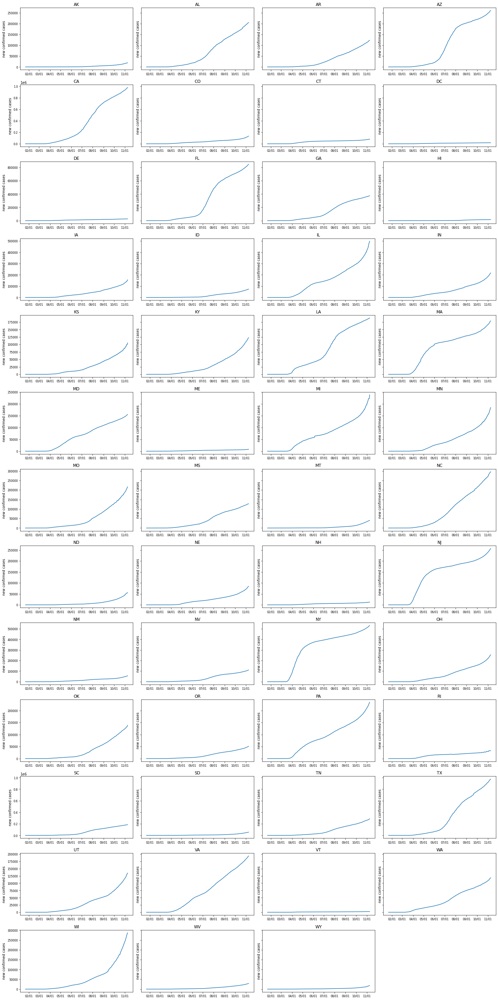

In [10]:
# Time-series visualization for the US and each state

fig, axs = plt.subplots(13, 4, figsize = (20,40),sharey='row')
i = 0

for ax in axs.ravel()[0:51]:
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%m/%d'))
    
    ax.tick_params(axis='both', which='major', labelsize=8)
    ax.set_title("%s"%(str(case_state_name[i])))

    ax.plot(case_state_date, case_state_num.iloc[i,:])
    
    ax.set_ylabel("new confirmed cases")
      
    i += 1
    

fig.delaxes(axs[12,3])
plt.tight_layout()
fig.savefig("graphs/new confirmed cases")

# 2. Social Distance Data

In [11]:
# Import social distance data

sd_data_folder_path = 'data/distance_data/'
data_names = ["national_2019", "state_2019", "county_2019",
             "national_2020", "state_2020", "county_2020"]
data_all = {}
for data_name in data_names:
    data = pd.read_csv(sd_data_folder_path+"%s.csv"%(data_name))
    
    data_all[data_name] = data
    print(data_name, data.shape)

national_2019 (304, 24)
state_2019 (15504, 24)
county_2019 (955168, 24)
national_2020 (305, 24)
state_2020 (15555, 24)
county_2020 (958310, 24)


In [12]:
# To compare 2019 and 2020, we need to drop Feb 29, 2020
visual_data = {}
for data_name in data_names:
    df = data_all[data_name]
    df = df[df["only_date"]!="02/29"]
    
    visual_data[data_name] = df
    print(data_name, df.shape)

national_2019 (304, 24)
state_2019 (15504, 24)
county_2019 (955168, 24)
national_2020 (304, 24)
state_2020 (15504, 24)
county_2020 (955168, 24)


In [13]:
# Choose dataset for time-series visualization

cur_state = visual_data["state_2020"]
prev_state = visual_data["state_2019"]

state_names = visual_data["state_2020"]["state_code"].unique()

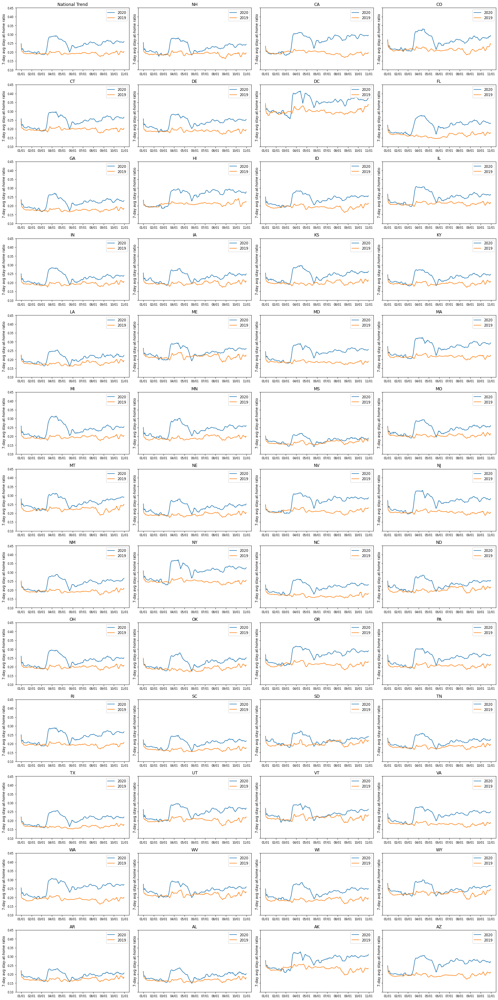

In [14]:
# Time-series visualization for the US and each state

converted_dates = list(map(datetime.datetime.strptime, visual_data["national_2020"]["date"].values, len(visual_data["national_2020"]["date"].values)*['%Y-%m-%d']))

fig, axs = plt.subplots(13, 4, figsize = (20,40),sharey='row')
i = 0

for ax in axs.ravel():
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%m/%d'))
    ax.tick_params(axis='both', which='major', labelsize=8)
    if i == 0:
        # plot national trend
        cur_df = visual_data["national_2020"]
        prev_df = visual_data["national_2019"]
        ax.set_title("National Trend")
    else:
        cur_df = cur_state[cur_state["state_code"] == state_names[i-1]]
        prev_df = prev_state[prev_state["state_code"] == state_names[i-1]]
        ax.set_title("%s"%(str(state_names[i-1])))

    ax.plot(converted_dates, cur_df["MA_7"], label = '2020')
    ax.plot(converted_dates, prev_df["MA_7"], label = '2019')
    ax.legend(loc = "upper right")
    ax.set_ylabel("7-day avg stay-at-home ratio")
    ax.set_ylim(0.1,0.45)
      
    i += 1
     
plt.tight_layout()
fig.savefig("graphs/avg SAT ratio for states 2 years.png", dpi = 200)

In [15]:
# Change fips from float to string
data_all["county_2020"]['county_fips'] = data_all["county_2020"]['county_fips'].apply(lambda x: str(int(x)).zfill(5))
data_all["county_2019"]['county_fips'] = data_all["county_2019"]['county_fips'].apply(lambda x: str(int(x)).zfill(5))

In [16]:
# Calculate ratio of different types of trips
dist_agg = {}
for data_name in data_names:
    df = data_all[data_name] 
    df["trip_ratio"] = df["trips"]/df["pop"]
    df["short_trips"] = df["trips_1"] + df["trips_1_3"] + df["trips_3_5"] + df["trips_5_10"]
    df["med_trips"] = df["trips_10_25"] + df["trips_25_50"] + df["trips_25_50"] 
    df["long_trips"] = + df["trips_50_100"] + df["trips_100_250"] + df["trips_250_500"] + df["trips_500"] 

    df["short_trip_ratio"] = df["short_trips"]/df["trips"]
    df["med_trip_ratio"] = df["med_trips"]/df["trips"]
    df["long_trip_ratio"] = df["long_trips"]/df["trips"]

    dist_agg[data_name] = df[['date', 'state_fips', 'state_code', 
                              'county_fips', 'county',
                              'pop_stay_at_home', 'pop_not_stay_at_home', 
                              'trip_ratio',"short_trip_ratio",
                              "med_trip_ratio", "long_trip_ratio",
                              "only_date", "weekday",
                              "avg_stay_at_home_ratio","MA_7"]]


In [17]:
# Calculate average statistics for each county
county_daily_avg = dist_agg["county_2020"].groupby(by = ["county_fips"], as_index = False).mean()
county_daily_avg.head(1)

,county_fips,state_fips,pop_stay_at_home,pop_not_stay_at_home,trip_ratio,short_trip_ratio,med_trip_ratio,long_trip_ratio,weekday,avg_stay_at_home_ratio,MA_7
0,01001,1.0,9723.537705,45877.462295,3.145253,0.74123,0.275765,0.027315,3.006557,0.174881,0.174785


In [18]:
# avereage number of trips taken by everyone daily
fig = px.choropleth(county_daily_avg, 
                    geojson=counties, 
                    color_continuous_scale="Spectral",
                    locations='county_fips', color='short_trip_ratio',
                    range_color=(np.min(county_daily_avg["short_trip_ratio"]), np.max(county_daily_avg["short_trip_ratio"])),
                    scope="usa",
                    #labels={'unemp':'unemployment rate'}
                    )
fig.update_layout(title_text = 'Average Proportion of Short Trips in Total Trips ', title_x=0.5,)
fig.write_image('graphs/short_trip_ratio.png',  format = "png", scale=2, engine="kaleido")

In [19]:
# average ratio of long trips for everyone in the county
fig = px.choropleth(county_daily_avg, 
                    geojson=counties, 
                    color_continuous_scale="balance",
                    locations='county_fips', color='trip_ratio',
                    range_color=(np.min(county_daily_avg["trip_ratio"]), np.max(county_daily_avg["trip_ratio"])),
                    scope="usa",
                    #labels={'unemp':'unemployment rate'}
                    )
fig.update_layout(title_text = 'Daily Num of Trips per Person',title_x=0.5)
fig.write_image('graphs/trip_ratio.png',  format = "png", scale=2, engine="kaleido")

In [20]:
# average ratio of long trips for everyone in the county
fig = px.choropleth(county_daily_avg, 
                    geojson=counties, 
                    color_continuous_scale="Spectral",
                    locations='county_fips', color='avg_stay_at_home_ratio',
                    range_color=(np.min(county_daily_avg["avg_stay_at_home_ratio"]), np.max(county_daily_avg["avg_stay_at_home_ratio"])),
                    scope="usa",
                    #labels={'unemp':'unemployment rate'}
                    )
fig.update_layout(title_text = 'Average Stay at Home Ratio', title_x=0.5)
fig.write_image('graphs/avg_stay_at_home_ratio.png',  format = "png", scale=2, engine="kaleido")

# 3. Policy Data 

## a. From KFF

In [21]:
## date range
start = datetime.datetime.strptime("2020-06-04", "%Y-%m-%d")
end = datetime.datetime.strptime("2020-11-14", "%Y-%m-%d")
date_generated = [start + datetime.timedelta(days=x) for x in range(0, (end-start).days)]

In [22]:
np.random.seed(109)
df_dict = {}
filename = "_Social_Distancing.csv"

for d in date_generated:
    date = str(d.strftime("%Y-%m-%d"))
    try:
        df_dict[date] = pd.read_csv('data/policy_data/'+str(date)+filename,skiprows=[1,2])
        df_dict[date].rename(columns={ df_dict[date].columns[0]: "Location" }, inplace = True)
    except:
        pass

In [23]:
curr_df = df_dict['2020-11-13']
print(curr_df.shape)
curr_df.head()

(51, 10)


,Location,Status of Reopening,Stay at Home Order,Mandatory Quarantine for Travelers,Non-Essential Business Closures,Large Gatherings Ban,Restaurant Limits,Bar Closures,Face Covering Requirement,Emergency Declaration
0,Alabama,Paused,Lifted,-,All Non-Essential Businesses Permitted to Reop...,Lifted,Reopened to Dine-in Service,Reopened,Required for General Public,Yes
1,Alaska,Proceeding with Reopening,Lifted,All Travelers,All Non-Essential Businesses Permitted to Reopen,Lifted,Reopened to Dine-in Service,Reopened,Required for Certain Employees,Yes
2,Arizona,New Restrictions Imposed,Lifted,Lifted,New Business Closures or Limits,New Limit on Large Gatherings in Place,New Service Limits,Newly Closed,Required for Certain Employees;\nAllows Local ...,Yes
3,Arkansas,Paused,-,Lifted,-,Lifted,Reopened to Dine-in Service with Capacity Limits,Reopened,Required for General Public,Yes
4,California,Proceeding with Reopening,Statewide,-,New Business Closures or Limits,All Gatherings Prohibited,Reopened to Dine-in Service with Capacity Limits,Newly Closed,Required for General Public,Yes


In [24]:
quarantine_df_test = curr_df[["Location","Mandatory Quarantine for Travelers"]]
quarantine_df_test.head()

,Location,Mandatory Quarantine for Travelers
0,Alabama,-
1,Alaska,All Travelers
2,Arizona,Lifted
3,Arkansas,Lifted
4,California,-


In [25]:
quarantine = {}
quarantine_df = quarantine_df_test[["Location"]]
for d in date_generated:
    date = str(d.strftime("%Y-%m-%d"))
    try:
        quarantine[date] = df_dict[date][["Location","Mandatory Quarantine for Travelers"]]
        quarantine_df[date] = df_dict[date]["Mandatory Quarantine for Travelers"]
    except:
        pass

In [26]:
# quarantine['2020-11-13']["Mandatory Quarantine for Travelers"].value_counts()
quarantine['2020-11-13']["Mandatory Quarantine for Travelers"] = quarantine['2020-11-13']["Mandatory Quarantine for Travelers"].replace("-","Nothing")

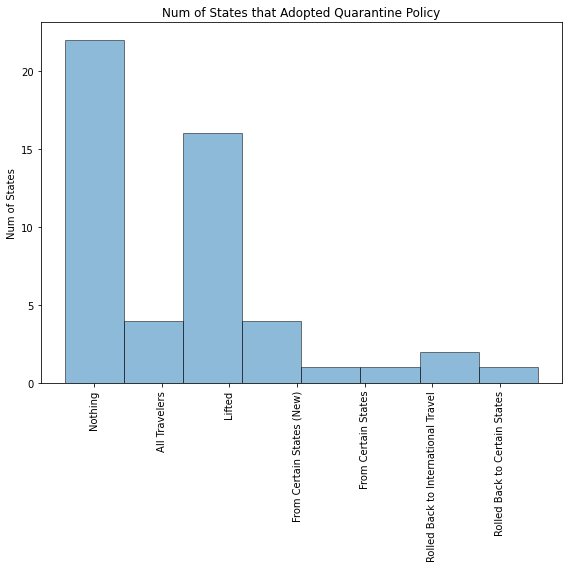

In [27]:
fig = plt.figure(figsize = (8,8))
plt.hist(quarantine['2020-11-13']["Mandatory Quarantine for Travelers"], 
         align = "left", alpha=0.5, histtype='bar', ec='black',bins = 8)
plt.xticks(rotation=90)
plt.ylabel("Num of States")
plt.title("Num of States that Adopted Quarantine Policy")
plt.tight_layout()
plt.savefig("graphs/Num of States that Adopted Quarantine Policy.png", dpi = 100)

In [28]:
quarantine_df.head()

,Location,2020-06-04,2020-06-05,2020-06-08,2020-06-12,2020-06-15,2020-06-17,2020-06-22,2020-06-24,2020-06-25,...,2020-09-24,2020-10-01,2020-10-05,2020-10-22,2020-10-23,2020-10-27,2020-11-02,2020-11-06,2020-11-11,2020-11-13
0,Alabama,All Travelers,-,-,-,-,-,-,-,-,...,-,-,-,-,-,-,-,-,-,-
1,Alaska,Lifted,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,...,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers,All Travelers
2,Arizona,From Certain States,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,...,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted
3,Arkansas,-,From Certain States,From Certain States,From Certain States,Lifted,Lifted,Lifted,Lifted,Lifted,...,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted,Lifted
4,California,-,-,-,-,-,-,-,-,-,...,-,-,-,-,-,-,-,-,-,-


## b. From CovidVis
https://github.com/covidvis/covid19-vis

In [29]:
# Import fisp file by Kieran Healy (@kjhealy) from github 
# To match state name with state code
state_name_code_path = "https://raw.githubusercontent.com/kjhealy/fips-codes/master/state_fips_master.csv"
state_name_code = pd.read_csv(state_name_code_path)
state_name_code.head()

,state_name,state_abbr,long_name,fips,sumlev,region,division,state,region_name,division_name
0,Alabama,AL,Alabama AL,1,40,3,6,1,South,East South Central
1,Alaska,AK,Alaska AK,2,40,4,9,2,West,Pacific
2,Arizona,AZ,Arizona AZ,4,40,4,8,4,West,Mountain
3,Arkansas,AR,Arkansas AR,5,40,3,7,5,South,West South Central
4,California,CA,California CA,6,40,4,9,6,West,Pacific


In [30]:
policy_df = pd.read_csv("data/policy_data/quarantine-activity-US-Apr16-long.csv")
print(policy_df.shape)
print(policy_df.columns)

(607, 20)
Index(['State', 'Coverage.type', 'Coverage.location', 'Effective Date',
       'State of Emergency Declaration', 'Travel Restrictions',
       'Shelter-in-place Order', 'Gathering Limitations',
       'Banning Gatherings of a Certain Size', 'K-12 School Closure',
       'Bar and Dine-in Restaurant Closure',
       'Non-essential Businesses Closure', 'Details (if any)',
       'Reference links', 'Timestamp', 'population_size',
       'population_reference', 'Coverage.county.FIPS', 'Coverage.city.FIPS',
       'population_reference.1'],
      dtype='object')


In [31]:
policy_df.head()

,State,Coverage.type,Coverage.location,Effective Date,State of Emergency Declaration,Travel Restrictions,Shelter-in-place Order,Gathering Limitations,Banning Gatherings of a Certain Size,K-12 School Closure,Bar and Dine-in Restaurant Closure,Non-essential Businesses Closure,Details (if any),Reference links,Timestamp,population_size,population_reference,Coverage.county.FIPS,Coverage.city.FIPS,population_reference.1
0,Alabama,State-wide,Alabama,3/13/20,State of Emergency declared,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,https://en.wikipedia.org/wiki/U.S._state_and_l...,4/10/20,4903185,1.0,NaN,NaN,https://www.census.gov/data/datasets/time-seri...
1,Alabama,State-wide,Alabama,3/27/20,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Some (cherry-picked) businesses closed,"On March 27, all non-essential businesses"" in ...",https://en.wikipedia.org/wiki/2020_coronavirus...,4/10/20,4903185,1.0,NaN,NaN,https://www.census.gov/data/datasets/time-seri...
2,Alabama,State-wide,Alabama,3/2/20,NaN,NaN,NaN,Suggested social distancing,NaN,NaN,NaN,NaN,"On March 2, the Alabama Department of Public H...",https://en.wikipedia.org/wiki/2020_coronavirus...,4/10/20,4903185,1.0,NaN,NaN,https://www.census.gov/data/datasets/time-seri...
3,Alabama,State-wide,Alabama,4/4/20,NaN,NaN,Shelter-in-place order,NaN,NaN,NaN,NaN,NaN,"On April 3, Governor Ivey issued a statewide s...",https://en.wikipedia.org/wiki/2020_coronavirus...,4/10/20,4903185,1.0,NaN,NaN,https://www.census.gov/data/datasets/time-seri...
4,Alabama,State-wide,Alabama,3/18/20,NaN,NaN,NaN,Banned gatherings of a certain size,50.0,Schools closed,NaN,NaN,"On March 12, all schools were closed from Marc...",https://en.wikipedia.org/wiki/2020_coronavirus...,4/10/20,4903185,1.0,NaN,NaN,https://www.census.gov/data/datasets/time-seri...


In [32]:
policies = ['Travel Restrictions',
       'Shelter-in-place Order', 'Gathering Limitations',
       'Banning Gatherings of a Certain Size', 'K-12 School Closure',
       'Bar and Dine-in Restaurant Closure',
       'Non-essential Businesses Closure']

In [33]:
policy_state_dfs = []
for policy in policies:
    cur_df = policy_df[~policy_df[policy].isna()].reset_index(drop = True)
    cur_df = cur_df[cur_df["Coverage.type"] == "State-wide"]
    cur_df = cur_df.merge(state_name_code, left_on = "State",
                    right_on="state_name", how = "inner")
    cur_df = cur_df[['State', 'Coverage.type', 'Coverage.location', 'Effective Date',
                 'State of Emergency Declaration','Details (if any)',
                'Reference links', 'Timestamp', 'population_size',
                'population_reference', 'state_name', 'state_abbr', 'fips', ]]

    
    policy_state_dfs.append(cur_df)
    print(policy, ":" ,len(cur_df))

Travel Restrictions : 9
Shelter-in-place Order : 39
Gathering Limitations : 35
Banning Gatherings of a Certain Size : 32
K-12 School Closure : 42
Bar and Dine-in Restaurant Closure : 20
Non-essential Businesses Closure : 25


In [34]:
data_all["state_2020"].head()

,county,county_fips,date,level,pop_not_stay_at_home,pop_stay_at_home,state_code,state_fips,trips,trips_1,...,pop,avg_stay_at_home_ratio,MA_7,trip_ratio,short_trips,med_trips,long_trips,short_trip_ratio,med_trip_ratio,long_trip_ratio
0,NaN,NaN,2020-01-01,State,1011972.0,344486.0,NH,33.0,4032895.0,809618.0,...,1356458.0,0.253960,0.253960,2.973107,2990842.0,1174595.0,115067.0,0.741612,0.291254,0.028532
1,NaN,NaN,2020-01-01,State,30337342.0,9219703.0,CA,6.0,112606885.0,31144582.0,...,39557045.0,0.233074,0.233074,2.846696,89291975.0,25547663.0,3321092.0,0.792953,0.226875,0.029493
2,NaN,NaN,2020-01-01,State,4161144.0,1534420.0,CO,8.0,18346137.0,4641274.0,...,5695564.0,0.269406,0.269406,3.221127,14415060.0,4172485.0,566284.0,0.785727,0.227431,0.030867
3,NaN,NaN,2020-01-01,State,2652707.0,919958.0,CT,9.0,9636627.0,2187052.0,...,3572665.0,0.257499,0.257499,2.697322,7511756.0,2331950.0,257191.0,0.779501,0.241988,0.026689
4,NaN,NaN,2020-01-01,State,718390.0,248781.0,DE,10.0,2665377.0,643220.0,...,967171.0,0.257225,0.257225,2.755849,2080296.0,659586.0,65641.0,0.780488,0.247464,0.024627


In [35]:
#Travel Restrictions
policy_state_dfs[0].head()

,State,Coverage.type,Coverage.location,Effective Date,State of Emergency Declaration,Details (if any),Reference links,Timestamp,population_size,population_reference,state_name,state_abbr,fips
0,Alaska,State-wide,Alaska,3/25/20,NaN,Mike Dunleavy ordered everyone arriving in Ala...,https://en.wikipedia.org/wiki/2020_coronavirus...,4/10/20,731545,2.0,Alaska,AK,2
1,Florida,State-wide,Florida,3/24/20,NaN,"On March 27, DeSantis expanded a previous orde...",https://www.usatoday.com/story/travel/airline-...,4/11/20,21477737,12.0,Florida,FL,12
2,Hawaii,State-wide,Hawaii,3/21/20,NaN,"On March 21, Ige ordered a 14-day mandatory qu...",https://en.wikipedia.org/wiki/U.S._state_and_l...,4/11/20,1415872,15.0,Hawaii,HI,15
3,Kentucky,State-wide,Kentucky,4/1/20,NaN,April 1 ‚Äì Gov. Beshear ordered Kentucky resi...,https://en.wikipedia.org/wiki/U.S._state_and_l...,4/11/20,4467673,21.0,Kentucky,KY,21
4,Massachusetts,State-wide,Massachusetts,3/27/20,NaN,"On March 27, Governor Baker asked travelers fr...",https://en.wikipedia.org/wiki/2020_coronavirus...,4/14/20,6892503,25.0,Massachusetts,MA,25


### Visualize policies' effects on stay-at-home ratio

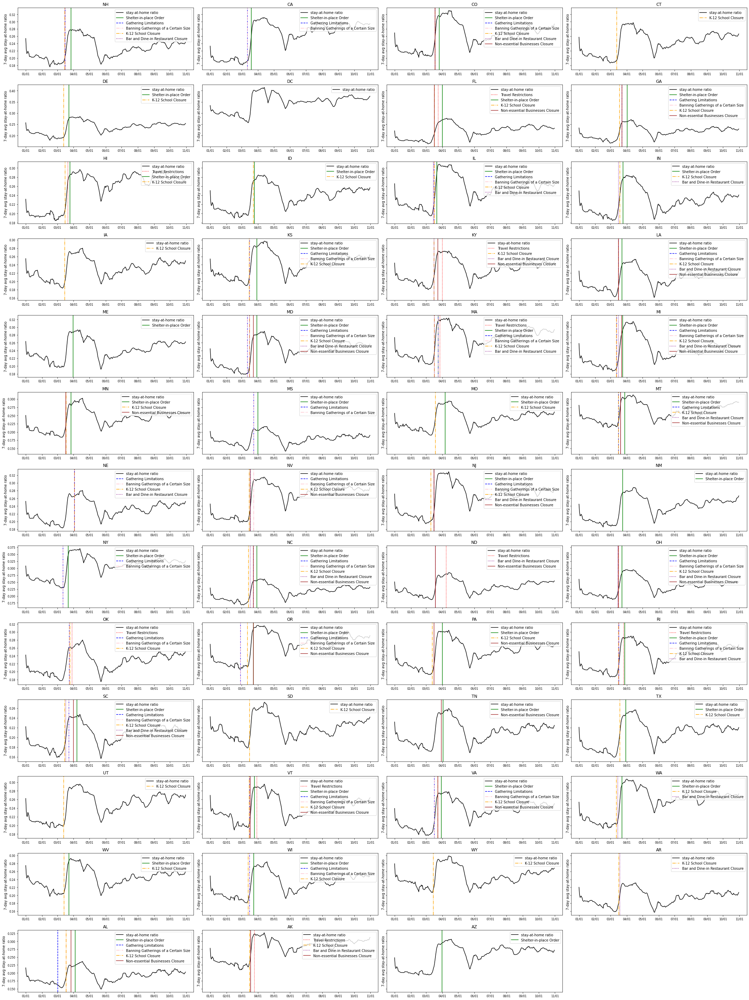

In [36]:

state_df = data_all["state_2020"]
state_names = state_df["state_code"].unique()
colors = ["red", "green","blue","pink", "orange","purple","brown"]
line_styles = [":",'-', '--', '-.',"dashdot","dotted","solid"]
converted_dates = list(map(datetime.datetime.strptime, data_all["national_2020"]["date"].values, len(data_all["national_2020"]["date"].values)*['%Y-%m-%d']))

fig, axs = plt.subplots(13, 4, figsize = (30,40),sharey='row')
i = 0
for ax in axs.ravel():
    if i == len(state_names):
        break

    cur_state = state_names[i]
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%m/%d'))
    ax.tick_params(axis='both', which='major', labelsize=8)
    
    cur_df = state_df[state_df["state_code"] == cur_state]
    ax.set_title("%s"%(str(cur_state)))

    # ax.plot(dates, cur_df['avg_stay_at_home_ratio'], label = "daily")
    ax.plot(converted_dates, cur_df["MA_7"], label = 'stay-at-home ratio',color = "black")
    
    for k in range(len(policies)):
        policy = policies[k]
        policy_state_df = policy_state_dfs[k]
        policy_states = policy_state_df["state_abbr"].values
        if cur_state in policy_states:
            index_ = list(policy_states).index(cur_state)
            policy_date = datetime.datetime.strptime(policy_state_df["Effective Date"][index_]+"20","%m/%d/%Y")
            ax.axvline(x=policy_date, label = "%s"%(policy), color = colors[k], linestyle=line_styles[k])
        

    ax.legend(loc = "upper right")
    ax.set_ylabel("7-day avg stay-at-home ratio")
      
    i += 1

fig.delaxes(axs[12,3])
plt.tight_layout()
fig.savefig("graphs/policies_vs_SAT_ratio.png")

### Visualize policies' effects on daily new cases

No handles with labels found to put in legend.


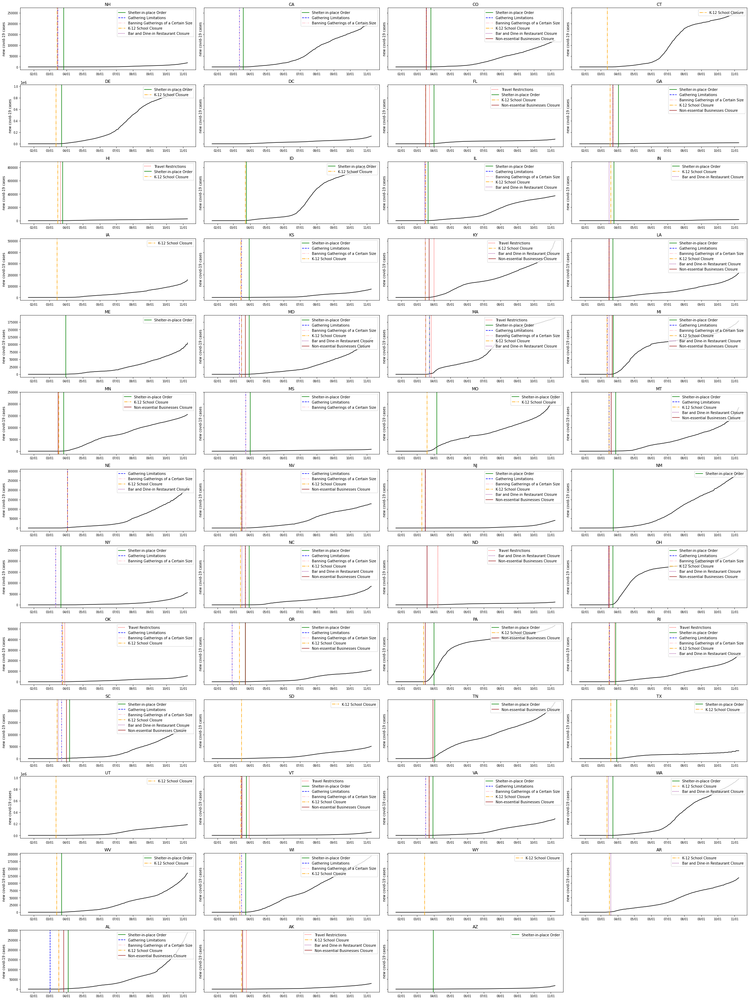

In [37]:
state_df = data_all["state_2020"]
state_names = state_df["state_code"].unique()
colors = ["red", "green","blue","pink", "orange","purple","brown"]
line_styles = [":",'-', '--', '-.',"dashdot","dotted","solid"]

fig, axs = plt.subplots(13, 4, figsize = (30,40),sharey='row')
i = 0
for ax in axs.ravel():
    if i == len(state_names):
        break

    cur_state = state_names[i]
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%m/%d'))
    ax.tick_params(axis='both', which='major', labelsize=8)
    
    ax.set_title("%s"%(str(cur_state)))

    # ax.plot(dates, cur_df['avg_stay_at_home_ratio'], label = "daily")
    ax.plot(case_state_date, case_state_num.iloc[i,:], color = "black")
    
    for k in range(len(policies)):
        policy = policies[k]
        policy_state_df = policy_state_dfs[k]
        policy_states = policy_state_df["state_abbr"].values
        if cur_state in policy_states:
            index_ = list(policy_states).index(cur_state)
            policy_date = datetime.datetime.strptime(policy_state_df["Effective Date"][index_]+"20","%m/%d/%Y")
            ax.axvline(x=policy_date, label = "%s"%(policy), color = colors[k], linestyle=line_styles[k])
        

    ax.legend(loc = "upper right")
    ax.set_ylabel("new covid-19 cases")
      
    i += 1

fig.delaxes(axs[12,3])
plt.tight_layout()
fig.savefig("graphs/policies_vs_new_cases.png")

# 4. Social Economics Data

In [38]:
# import social and economic data for each country
social_data = pd.read_csv('data/social_economics/ACSDP5Y2018.DP02_data_with_overlays_2020-10-12T093324.csv')
eco_data =  pd.read_csv('data/social_economics/ACSDP5Y2018.DP03_data_with_overlays_2020-11-09T135613.csv')

# rename columns 
social_data.columns = social_data.iloc[0,:]
social_data = social_data[1:]

eco_data.columns = eco_data.iloc[0,:]
eco_data = eco_data[1:]

display(social_data.head())
display(eco_data.head())

/Users/mac/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning:

Columns (2,3,4,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,62,63,66,67,68,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,146,147,148,149,150,151,154,155,158,159,162,163,166,167,170,171,172,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,198,199,202,203,206,207,208,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,274,27

,id,Geographic Area Name,Estimate!!HOUSEHOLDS BY TYPE!!Total households,Margin of Error!!HOUSEHOLDS BY TYPE!!Total households,Percent Estimate!!HOUSEHOLDS BY TYPE!!Total households,Percent Margin of Error!!HOUSEHOLDS BY TYPE!!Total households,Estimate!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families),Margin of Error!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families),Percent Estimate!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families),Percent Margin of Error!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families),...,Percent Estimate!!COMPUTERS AND INTERNET USE!!Total households,Percent Margin of Error!!COMPUTERS AND INTERNET USE!!Total households,Estimate!!COMPUTERS AND INTERNET USE!!Total households!!With a computer,Margin of Error!!COMPUTERS AND INTERNET USE!!Total households!!With a computer,Percent Estimate!!COMPUTERS AND INTERNET USE!!Total households!!With a computer,Percent Margin of Error!!COMPUTERS AND INTERNET USE!!Total households!!With a computer,Estimate!!COMPUTERS AND INTERNET USE!!Total households!!With a broadband Internet subscription,Margin of Error!!COMPUTERS AND INTERNET USE!!Total households!!With a broadband Internet subscription,Percent Estimate!!COMPUTERS AND INTERNET USE!!Total households!!With a broadband Internet subscription,Percent Margin of Error!!COMPUTERS AND INTERNET USE!!Total households!!With a broadband Internet subscription
1,0500000US01001,"Autauga County, Alabama",21115,383,21115,(X),15161,488,71.8,2.3,...,21115,(X),18368,482,87.0,1.7,16651,500,78.9,1.9
2,0500000US01003,"Baldwin County, Alabama",78622,1183,78622,(X),51359,1309,65.3,1.4,...,78622,(X),69635,1314,88.6,0.8,61424,1421,78.1,1.3
3,0500000US01005,"Barbour County, Alabama",9186,280,9186,(X),6030,284,65.6,2.7,...,9186,(X),6986,236,76.1,2.2,5548,273,60.4,2.7
4,0500000US01007,"Bibb County, Alabama",6840,321,6840,(X),4947,366,72.3,3.7,...,6840,(X),5217,376,76.3,3.6,4521,362,66.1,3.9
5,0500000US01009,"Blount County, Alabama",20600,396,20600,(X),15104,429,73.3,2.0,...,20600,(X),16202,526,78.7,2.0,14103,457,68.5,1.9


,id,Geographic Area Name,Estimate!!EMPLOYMENT STATUS!!Population 16 years and over,Margin of Error!!EMPLOYMENT STATUS!!Population 16 years and over,Percent Estimate!!EMPLOYMENT STATUS!!Population 16 years and over,Percent Margin of Error!!EMPLOYMENT STATUS!!Population 16 years and over,Estimate!!EMPLOYMENT STATUS!!Population 16 years and over!!In labor force,Margin of Error!!EMPLOYMENT STATUS!!Population 16 years and over!!In labor force,Percent Estimate!!EMPLOYMENT STATUS!!Population 16 years and over!!In labor force,Percent Margin of Error!!EMPLOYMENT STATUS!!Population 16 years and over!!In labor force,...,Percent Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!All people!!18 years and over!!65 years and over,Percent Margin of Error!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!All people!!18 years and over!!65 years and over,Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!People in families,Margin of Error!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!People in families,Percent Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!People in families,Percent Margin of Error!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!People in families,Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Unrelated individuals 15 years and over,Margin of Error!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Unrelated individuals 15 years and over,Percent Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Unrelated individuals 15 years and over,Percent Margin of Error!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Unrelated individuals 15 years and over
1,0500000US01001,"Autauga County, Alabama",43368,203,43368,(X),25736,653,59.3,1.6,...,8.7,2.4,(X),(X),14.0,2.4,(X),(X),24.3,3.6
2,0500000US01003,"Baldwin County, Alabama",167712,321,167712,(X),98030,1549,58.5,0.9,...,8.0,1.1,(X),(X),7.9,1.0,(X),(X),23.2,2.1
3,0500000US01005,"Barbour County, Alabama",20948,82,20948,(X),9638,434,46.0,2.0,...,16.2,3.4,(X),(X),27.8,3.4,(X),(X),34.4,5.1
4,0500000US01007,"Bibb County, Alabama",18470,132,18470,(X),8757,521,47.4,2.8,...,8.1,3.1,(X),(X),11.3,4.0,(X),(X),31.9,6.1
5,0500000US01009,"Blount County, Alabama",45915,159,45915,(X),22306,734,48.6,1.6,...,10.1,2.1,(X),(X),12.2,2.0,(X),(X),30.4,4.3


In [39]:
# merge the data
social_eco = pd.merge(social_data, eco_data, on=['id','Geographic Area Name'])
print('shape of social data:',social_data.shape)
print('shape of eco data:',eco_data.shape)
print('shape of merged data:',social_eco.shape)

shape of social data: (3220, 610)
shape of eco data: (3220, 550)
shape of merged data: (3220, 1158)


In [40]:
social_eco.describe()

,id,Geographic Area Name,Estimate!!HOUSEHOLDS BY TYPE!!Total households,Margin of Error!!HOUSEHOLDS BY TYPE!!Total households,Percent Estimate!!HOUSEHOLDS BY TYPE!!Total households,Percent Margin of Error!!HOUSEHOLDS BY TYPE!!Total households,Estimate!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families),Margin of Error!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families),Percent Estimate!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families),Percent Margin of Error!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families),...,Percent Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!All people!!18 years and over!!65 years and over,Percent Margin of Error!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!All people!!18 years and over!!65 years and over,Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!People in families,Margin of Error!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!People in families,Percent Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!People in families,Percent Margin of Error!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!People in families,Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Unrelated individuals 15 years and over,Margin of Error!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Unrelated individuals 15 years and over,Percent Estimate!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Unrelated individuals 15 years and over,Percent Margin of Error!!PERCENTAGE OF FAMILIES AND PEOPLE WHOSE INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!Unrelated individuals 15 years and over
count,3220,3220,3142,3142,3142,3142,3142,3142,3142.0,3142.0,...,3220,3220,3220,3220,3220,3220,3220,3220,3220,3220
unique,3220,3220,3048,1315,3048,1,3013,1446,525.0,183.0,...,488,224,1,1,619,191,1,1,781,281
top,0500000US48165,"Miami County, Ohio",856,90,856,(X),6864,191,66.5,1.5,...,7.6,1.8,(X),(X),10.1,2.0,(X),(X),25.4,3.3
freq,1,1,3,12,3,3142,3,11,30.0,67.0,...,40,63,3220,3220,24,87,3220,3220,21,42


We find that all the columns are object type, so next we will do some data cleaning to remove rows which contains nan and cols whcich contain string.

In [41]:
social_eco = social_eco.dropna(axis=0,how='any')

# only select cols that are 'estimate' rather than 'margin of error'
social_eco = social_eco[social_eco.columns[:2].append(social_eco.columns[pd.Series(social_eco.columns).str.startswith('Estimate')])]
print('cols that are estimates:',social_eco.shape)

# remove cols that contain string
discard_col = []
for col in social_eco.columns:
    try:
        social_eco[col] = social_eco[col].astype(float)
    except:
        discard_col.append(col)

useful_cols = list(social_eco.columns[:2])+list(set(social_eco.columns)-set(discard_col))
print('useful columns length:',len(useful_cols))

cols that are estimates: (3142, 291)
useful columns length: 150


In [42]:
social_eco_clean = social_eco[useful_cols]
social_eco_clean['fip']=social_eco_clean['id'].apply(lambda x:x[-5:])
social_eco_clean.describe()

,"Estimate!!WORLD REGION OF BIRTH OF FOREIGN BORN!!Foreign-born population, excluding population born at sea!!Oceania",Estimate!!ANCESTRY!!Total population!!American,Estimate!!YEAR OF ENTRY!!Population born outside the United States!!Native!!Entered before 2010,Estimate!!PLACE OF BIRTH!!Total population!!Native!!Born in United States,Estimate!!DISABILITY STATUS OF THE CIVILIAN NONINSTITUTIONALIZED POPULATION!!Under 18 years!!With a disability,Estimate!!ANCESTRY!!Total population!!Lithuanian,Estimate!!GRANDPARENTS!!Number of grandparents living with own grandchildren under 18 years!!Years responsible for grandchildren!!3 or 4 years,Estimate!!ANCESTRY!!Total population!!French Canadian,Estimate!!DISABILITY STATUS OF THE CIVILIAN NONINSTITUTIONALIZED POPULATION!!65 years and over!!With a disability,Estimate!!YEAR OF ENTRY!!Population born outside the United States,...,"Estimate!!HOUSEHOLDS BY TYPE!!Total households!!Family households (families)!!Male householder, no wife present, family!!With own children of the householder under 18 years",Estimate!!MARITAL STATUS!!Males 15 years and over!!Divorced,Estimate!!DISABILITY STATUS OF THE CIVILIAN NONINSTITUTIONALIZED POPULATION!!65 years and over,Estimate!!GRANDPARENTS!!Number of grandparents living with own grandchildren under 18 years!!Years responsible for grandchildren!!5 or more years,Estimate!!RELATIONSHIP!!Population in households!!Householder,Estimate!!ANCESTRY!!Total population!!German,Estimate!!HEALTH INSURANCE COVERAGE!!Civilian noninstitutionalized population!!With health insurance coverage!!With public coverage,Estimate!!ANCESTRY!!Total population!!Scotch-Irish,Estimate!!ANCESTRY!!Total population!!Dutch,Estimate!!ANCESTRY!!Total population!!Subsaharan African
count,3142.000000,3142.000000,3142.000000,3.142000e+03,3142.000000,3142.000000,3142.000000,3142.000000,3142.000000,3.142000e+03,...,3142.000000,3142.000000,3.142000e+03,3142.000000,3.142000e+03,3142.000000,3.142000e+03,3142.000000,3142.000000,3142.000000
mean,81.903565,6581.353596,1310.254615,8.731229e+04,975.550286,201.247931,130.747613,666.932845,5336.086251,1.545761e+04,...,868.663908,3866.914386,1.525813e+04,345.833546,3.810634e+04,14056.256525,3.506905e+04,961.514004,1276.027689,1142.538192
std,615.706416,14071.538181,5405.421623,2.421831e+05,2655.425560,956.650407,381.765055,2638.892087,15016.838799,9.715580e+04,...,2761.733085,10536.530888,4.387641e+04,1002.939528,1.156989e+05,32707.978064,1.147177e+05,2202.158364,3806.886390,5343.517345
min,0.000000,0.000000,0.000000,7.000000e+01,0.000000,0.000000,0.000000,0.000000,5.000000,0.000000e+00,...,0.000000,0.000000,7.000000e+00,0.000000,3.300000e+01,0.000000,1.400000e+01,0.000000,0.000000,0.000000
25%,0.000000,777.000000,39.000000,1.052750e+04,103.000000,0.000000,8.000000,14.000000,778.250000,2.430000e+02,...,87.000000,527.250000,1.983750e+03,34.000000,4.231750e+03,1328.500000,4.348250e+03,95.000000,110.000000,6.000000
50%,0.000000,2442.500000,126.000000,2.480100e+04,285.000000,9.000000,39.000000,63.000000,1775.500000,8.055000e+02,...,238.000000,1224.500000,4.481500e+03,115.000000,9.875000e+03,3794.500000,1.008750e+04,271.000000,332.500000,51.000000
75%,18.000000,6596.250000,463.000000,6.472125e+04,758.750000,70.000000,114.750000,322.500000,4133.750000,3.479750e+03,...,644.750000,3028.500000,1.145200e+04,305.000000,2.602025e+04,12001.750000,2.492750e+04,836.000000,1023.500000,300.750000
max,18883.000000,294845.000000,94161.000000,6.523632e+06,66832.000000,34981.000000,9469.000000,52665.000000,454812.000000,3.574420e+06,...,87646.000000,270845.000000,1.271912e+06,29470.000000,3.306109e+06,552809.000000,3.809323e+06,32103.000000,112324.000000,92200.000000


In [43]:
# select a column and visualize the information on a map
fig = px.choropleth(social_eco_clean, 
                    geojson=counties, 
                    color_continuous_scale="balance",
                    locations='fip', color='Estimate!!HOUSEHOLDS BY TYPE!!Total households!!Average household size',
                    range_color=(np.min(social_eco_clean['Estimate!!HOUSEHOLDS BY TYPE!!Total households!!Average household size']), 
                                 np.max(social_eco_clean['Estimate!!HOUSEHOLDS BY TYPE!!Total households!!Average household size'])),
                    
                    scope="usa",
                    )
fig.update_layout(
    
    title_text = '2018 Estimate Average Household size',
    geo_scope='usa', # limite map scope to USA
)
fig.write_image('graphs/2018_Estimate_Average_Household_size.png',  format = "png", scale=2, engine="kaleido")

In [44]:
case_social_eco=pd.merge(case,social_eco_clean,on='fip')
case_social_eco = case_social_eco.dropna(axis=0,how='any')

In [45]:
# Select important features
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge

scaled_x = StandardScaler().fit_transform(case_social_eco[useful_cols[2:]])
y = case_social_eco['10/14/20']

clf = Ridge(alpha=0.01)
clf.fit(scaled_x, y)
print("prediction score: %.4f"%clf.score(scaled_x,y))

prediction score: 0.9914


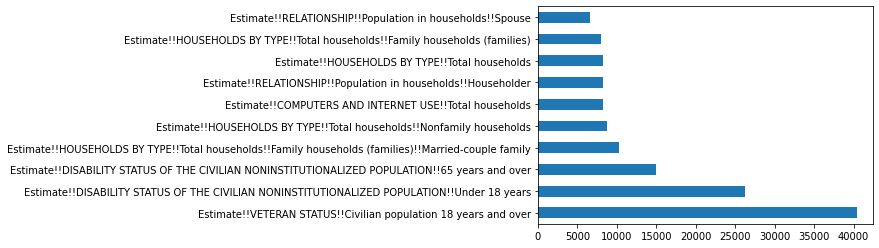

In [46]:
(pd.Series(clf.coef_, index=useful_cols[2:])
   .nlargest(10)
   .plot(kind='barh')) 

### That's insteresting. Why veteran status is strongly correlated with covid cases? Let's see from the map.

In [47]:
fig = px.choropleth(social_eco_clean, 
                    geojson=counties, 
                    color_continuous_scale="balance",
                    locations='fip', color='Estimate!!VETERAN STATUS!!Civilian population 18 years and over',
                    range_color=(np.min(social_eco_clean['Estimate!!VETERAN STATUS!!Civilian population 18 years and over']), 
                                 np.max(social_eco_clean['Estimate!!VETERAN STATUS!!Civilian population 18 years and over'])),

                    
                    scope="usa",
                    )
fig.update_layout(
    title_text = '2018 Estimate VETERAN STATUS-Civilian population 18 years and over',
    geo_scope='usa', # limite map scope to USA
)
fig.show()
fig.write_image('graphs/2018_Estimate_VETERAN_STATUS_Civilian.png',  format = "png", scale=2, engine="kaleido")

In [48]:
fig = px.choropleth(case_social_eco, 
                    geojson=counties, 
                    color_continuous_scale="balance",
                    locations='fip', color='10/14/20',
                    scope="usa",
                    )
fig.update_layout(
    title_text = '10/14/20 confirmed cases',
    geo_scope='usa', # limite map scope to USA
)
fig.show()

Indeed, the geographic distribution of veteran status and covid cases is similar: most are in California. We think it may due to the fact that some veterans would move to California to get better education and career. Since the social-economics data is constant over the year, we don't think it would be a good predictor for predicting daily confirmed covid cases, but we think we can use the data to find some particular patterns between social-economics and covid cases later.